In [88]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

import scipy
import scipy.stats as sps
import math

import sklearn
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import (
    cross_val_score,
    KFold,
    cross_validate,
    cross_val_predict,
)
from sklearn.preprocessing import LabelEncoder

import catboost
import lightgbm as lgb

import shap

# Тщательный анализ данных

In [3]:
train_df = pd.read_csv("train.csv")
test_df = pd.read_csv("test.csv")
sample_submission = pd.read_csv("submission.csv")

target_name = "SalePrice"
target = train_df[target_name]

In [50]:
train_df.shape, test_df.shape

((1460, 83), (1459, 82))

In [51]:
df = pd.concat((train_df, test_df), axis = 0)

## Наличие пропусков

In [ ]:
train_df.describe()

In [8]:
s = train_df.isna().mean()
s[s > 0]

LotFrontage     0.177397
Alley           0.937671
MasVnrType      0.005479
MasVnrArea      0.005479
BsmtQual        0.025342
BsmtCond        0.025342
BsmtExposure    0.026027
BsmtFinType1    0.025342
BsmtFinType2    0.026027
Electrical      0.000685
FireplaceQu     0.472603
GarageType      0.055479
GarageYrBlt     0.055479
GarageFinish    0.055479
GarageQual      0.055479
GarageCond      0.055479
PoolQC          0.995205
Fence           0.807534
MiscFeature     0.963014
dtype: float64

In [4]:
columns_with_miss = train_df.columns[train_df.isna().any(axis=0)]
train_df[columns_with_miss].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 19 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   LotFrontage   1201 non-null   float64
 1   Alley         91 non-null     object 
 2   MasVnrType    1452 non-null   object 
 3   MasVnrArea    1452 non-null   float64
 4   BsmtQual      1423 non-null   object 
 5   BsmtCond      1423 non-null   object 
 6   BsmtExposure  1422 non-null   object 
 7   BsmtFinType1  1423 non-null   object 
 8   BsmtFinType2  1422 non-null   object 
 9   Electrical    1459 non-null   object 
 10  FireplaceQu   770 non-null    object 
 11  GarageType    1379 non-null   object 
 12  GarageYrBlt   1379 non-null   float64
 13  GarageFinish  1379 non-null   object 
 14  GarageQual    1379 non-null   object 
 15  GarageCond    1379 non-null   object 
 16  PoolQC        7 non-null      object 
 17  Fence         281 non-null    object 
 18  MiscFeature   54 non-null   

### Предпринято
В работе были использованы различные подходы работы с пустыми значениями - некоторые модели использовали удаление признаков с пустыми значениями, некоторые заполняли средними значениями, некоторые использовали интерполяцию (Iterative imputing)

In [34]:
float_columns = [
    "LotFrontage",
    "LotArea",
    "MasVnrArea",
    "BsmtFinSF1",
    "BsmtFinSF2",
    "BsmtUnfSF",
    "1stFlrSF",
    "2ndFlrSF",
    "LowQualFinSF",
    "GrLivArea",
    "TotRmsAbvGrd",
    "GarageArea",
    "TotalBsmtSF",
    "WoodDeckSF",
    "OpenPorchSF",
    "EnclosedPorch",
    "3SsnPorch",
    "ScreenPorch",
    "PoolArea",
    "OverallQual",
    "GarageYrBlt",
    "YearBuilt",
    "YearRemodAdd",
]

categorical_columns = [
    "MSSubClass",
    "MSZoning",
    "Alley",
    "LotShape",
    "LandContour",
    "Utilities",
    "LotConfig",
    "LandSlope",
    "Neighborhood",
    "Condition1",
    "Condition2",
    "BldgType",
    "HouseStyle",
    "OverallCond",
    "RoofStyle",
    "RoofMatl",
    "Exterior1st",
    "Exterior2nd",
    "MasVnrType",
    "ExterQual",
    "ExterCond",
    "Foundation",
    "BsmtQual",
    "BsmtCond",
    "BsmtExposure",
    "BsmtFullBath",
    "BsmtFinType1",
    "BsmtFinType2",
    "Heating",
    "HeatingQC",
    "Electrical",
    "KitchenQual",
    "Functional",
    "FireplaceQu",
    "GarageFinish",
    "GarageQual",
    "GarageCond",
    "PavedDrive",
    "PoolQC",
    "Fence",
    "MiscFeature",
    "SaleType",
    "SaleCondition",
    "BsmtFullBath",
    "BsmtHalfBath",
    "FullBath",
    "HalfBath",
    "BedroomAbvGr",
    "KitchenAbvGr",
    "Fireplaces",
    "GarageType",
    "GarageCars",
    "YrSold",
    "MoSold",
    "Street", 
    "CentralAir"]


## Проверка наличия категорий в тестовой выборке, которых не было в обучающей
Проверяется наличие всех категорий используемых в тестовой выборке в обучающей.

In [16]:
for col in categorical_columns:
    diff = set(test_df[col].unique()).difference(set(train_df[col].unique()))
    if (len(diff) > 0) :
        print(col)
        print(set(test_df[col].unique()).difference(set(train_df[col].unique())))


MSSubClass
{150}
MSZoning
{nan}
Utilities
{nan}
Exterior1st
{nan}
Exterior2nd
{nan}
BsmtFullBath
{nan}
KitchenQual
{nan}
Functional
{nan}
SaleType
{nan}


### Вывод
Только в одной переменной найдена такая ситуация - количество образцев с такой категорией мало, поэтому проблема не рассматривается отдельно

# Распределение целевой переменной

График распределения показывает явное смещение центра веса выборки влево. Преобразование Бокса-кокса помогает избавится от этой проблемы. В некоторых из моделей это преобразование было использовано в качестве препроцессинга в обучении.

<AxesSubplot:ylabel='Count'>

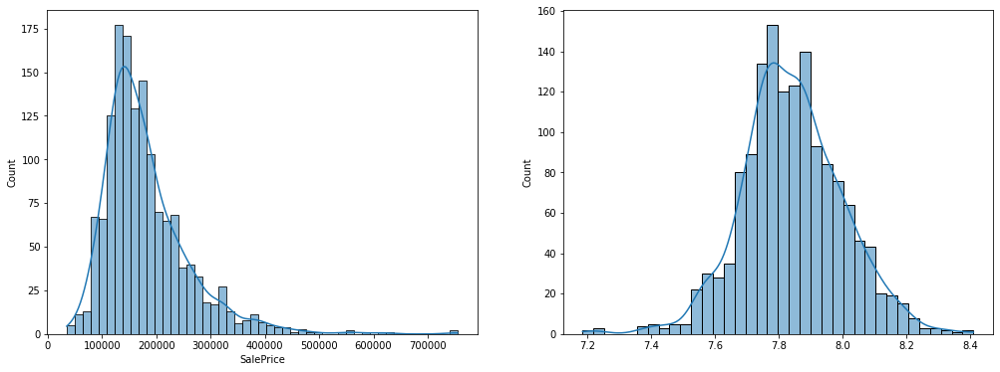

In [30]:
fig,(ax1,ax2) = plt.subplots(1,2, figsize = (17,6))
sns.histplot(train_df['SalePrice'], kde=True, ax=ax1)
sns.histplot(target_normal, kde=True, ax=ax2)

<AxesSubplot:xlabel='SalePrice'>

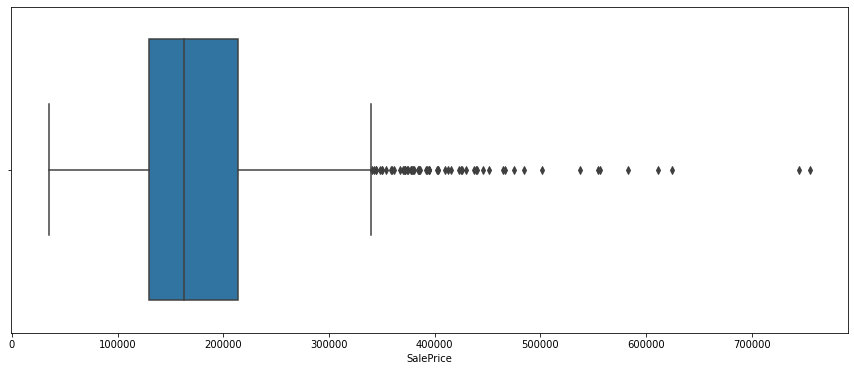

In [22]:
plt.figure(figsize=(15,6))
sns.boxplot(x = target_name, data = train_df)

In [31]:
def plot_box_hist(cat):
    f, (a0, a1) = plt.subplots(
        1, 2, gridspec_kw={"width_ratios": [2, 1]}, figsize=(19, 5)
    )
    sns.boxplot(x=cat, y=target_name, data=train_df.fillna("None"), ax=a0)
    plt.setp(a0.get_xticklabels(), rotation=45)
    sns.histplot(data=train_df[cat].fillna("None").astype(str), ax=a1)
    plt.setp(a1.get_xticklabels(), rotation=45)
    f.tight_layout()

    rects = a1.patches
    labels = [cat.get_text() for cat in a1.get_xticklabels()]
    labels = [
        "{}".format((train_df[cat].astype(str) == label).sum()) for label in labels
    ]
    for rect, label in zip(rects, labels):
        height = rect.get_height()
        a1.text(
            rect.get_x() + rect.get_width() / 2,
            height + 0.01,
            label,
            ha="center",
            va="bottom",
        )
    plt.show()


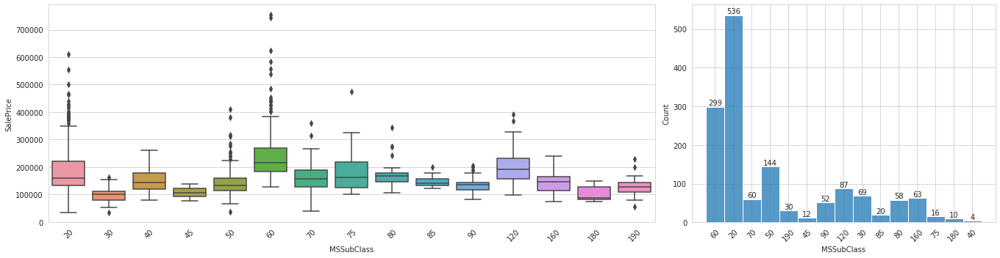

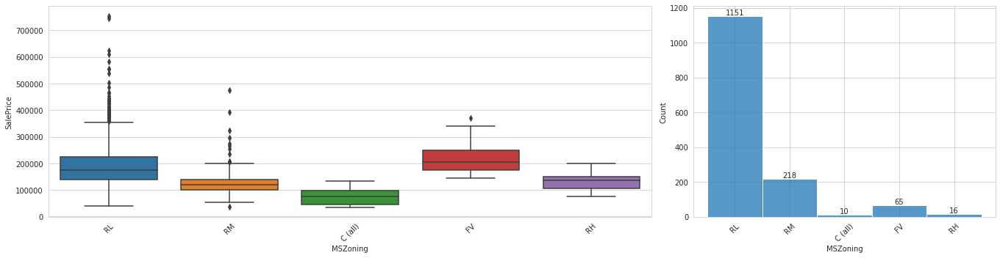

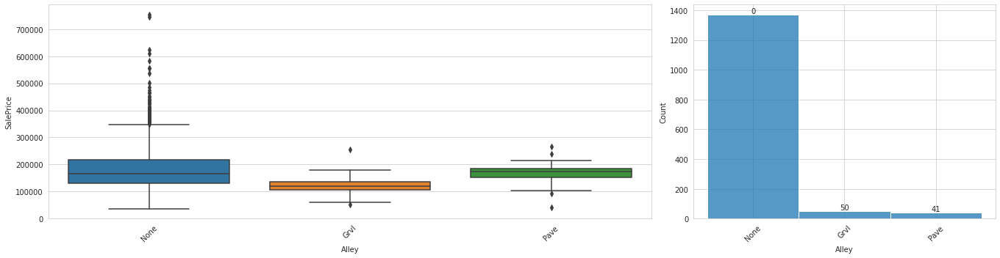

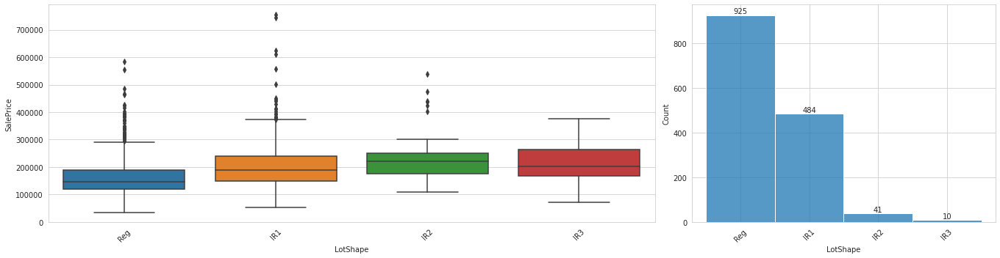

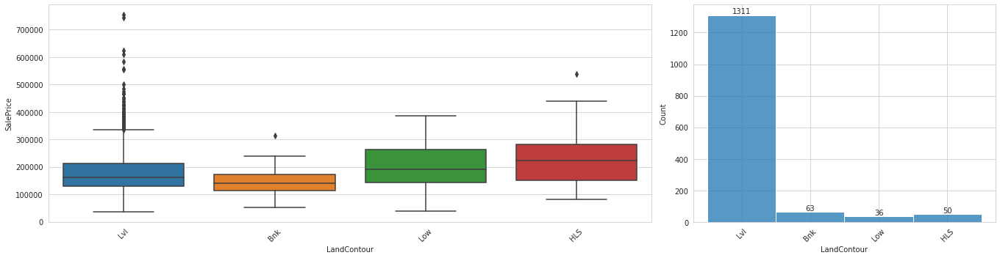

...

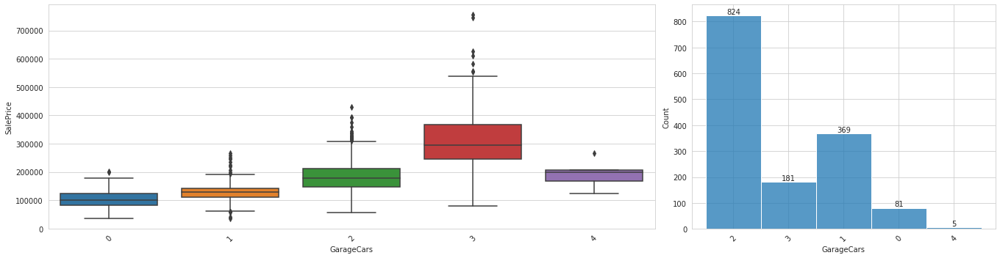

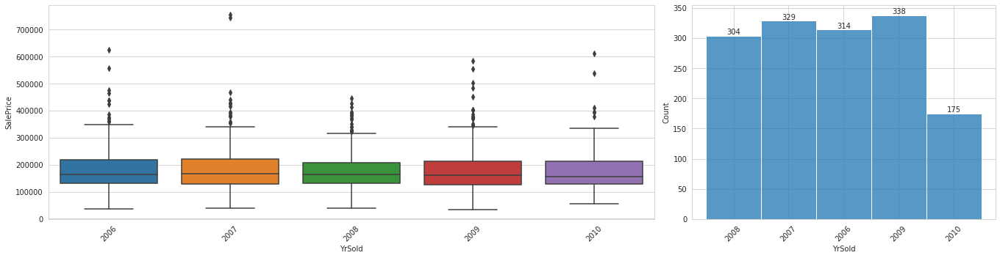

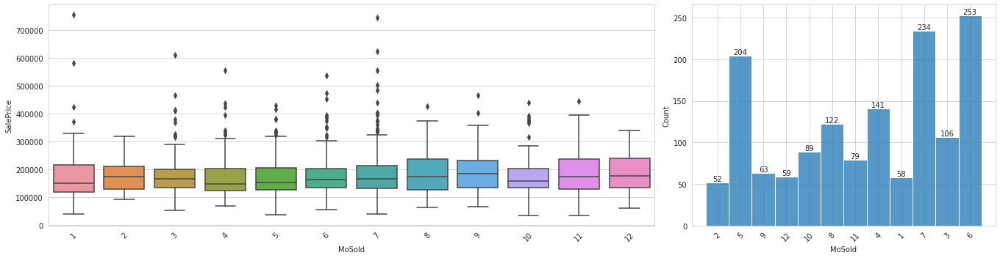

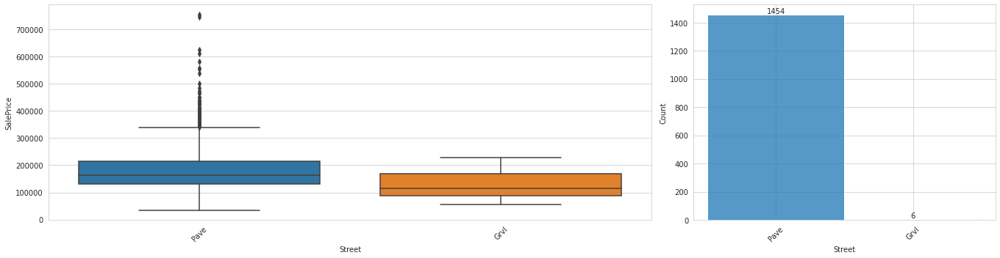

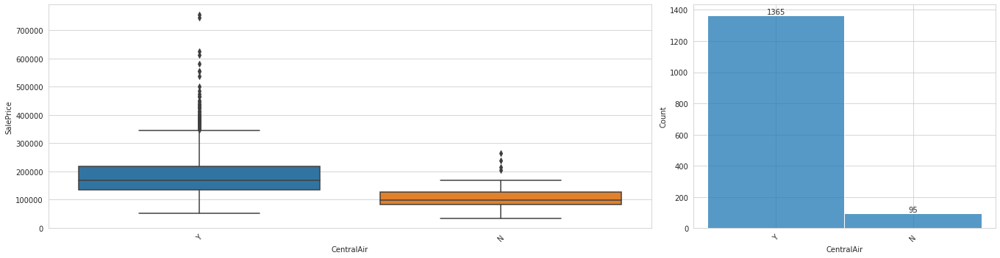

In [35]:
with sns.plotting_context(font_scale=1.8), sns.axes_style("whitegrid"):
    for cat in categorical_columns:
        plot_box_hist(cat)

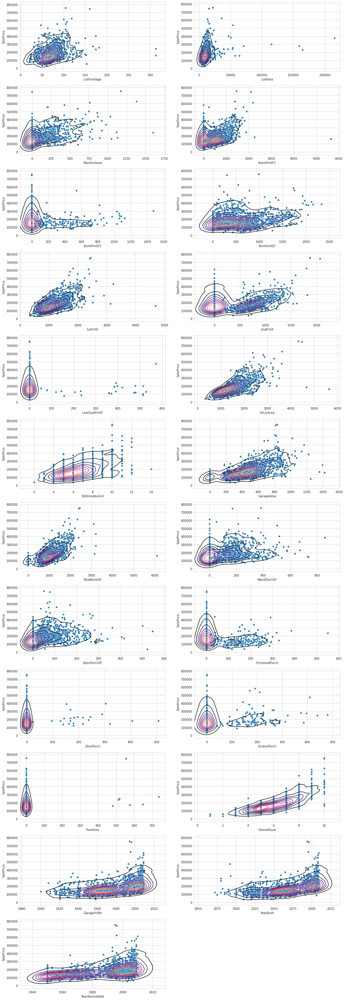

In [36]:
with sns.plotting_context(font_scale=1.5), sns.axes_style("whitegrid"):
    n = len(float_columns)
    plt.figure(figsize=(19, 5*(n+1)//2))
    for i, col in enumerate(float_columns):
        plt.subplot((n+1)//2, 2, i+1)
        sns.scatterplot(x = col, y = target_name, data = train_df, )
        sns.kdeplot(x = col, y = target_name, data = train_df, cmap = 'magma')

# Гипотезы важных признаков
Ниже изложены несколько вариантов важных признаков. Для них же представленны графики совместного распределения

## Вариант 1

В данном варианте одним из кандидатов на важный признак является возраст здания и срок его последнего кап ремонта. Эти признаки представлены ниже

In [44]:
train_df["AgeBuild"] = train_df["YrSold"] - train_df["YearBuilt"]
test_df["AgeBuild"] = test_df["YrSold"] - test_df["YearBuilt"]

train_df["AgeRemod"] = train_df["YrSold"] - train_df["YearRemodAdd"]
test_df["AgeRemod"] = test_df["YrSold"] - test_df["YearRemodAdd"]

float_columns.extend(["AgeBuild", "AgeRemod"])


In [45]:
important_features = [
    "AgeBuild",
    "TotalBsmtSF",
    "GrLivArea",
    "GarageArea",
    "OverallQual",
    "Neighborhood",
    "MasVnrArea",
    "OverallCond",
    "MSZoning",
]


### Корреляция Спирмана

In [46]:
for float_cat in [
    "AgeBuild",
    "TotalBsmtSF",
    "GrLivArea",
    "GarageArea",
    "OverallQual",
    "MasVnrArea",
]:
    print(
        float_cat,
        scipy.stats.spearmanr(
            train_df.loc[~train_df[float_cat].isna(), target_name],
            train_df.loc[~train_df[float_cat].isna(), float_cat],
        ),
    )


AgeBuild SpearmanrResult(correlation=-0.6501196678153068, pvalue=3.914550572021607e-176)
TotalBsmtSF SpearmanrResult(correlation=0.6027254448924096, pvalue=4.157299803636561e-145)
GrLivArea SpearmanrResult(correlation=0.7313095834659141, pvalue=1.4310154533091797e-244)
GarageArea SpearmanrResult(correlation=0.6493785338868229, pvalue=1.320918093357304e-175)
OverallQual SpearmanrResult(correlation=0.8098285862017292, pvalue=0.0)
MasVnrArea SpearmanrResult(correlation=0.4213094993288471, pvalue=1.4726128013810823e-63)


p - value в данном случае говорит о том, что нулевая гипотеза о том что признаки некоррелируют может быть отвергнута для вещественных признаков

### Хи квадрат

In [48]:
bins = np.linspace(
    train_df[target_name].quantile(0.01), train_df[target_name].quantile(0.99), 7
)
overall_distr = pd.cut(train_df[target_name], bins).value_counts().sort_index()
for feature in ["Neighborhood", "OverallCond", "MSZoning"]:
    for category in train_df[feature].unique():
        neighborhood_distr = (
            pd.cut(train_df.loc[train_df[feature] == category, target_name], bins)
            .value_counts()
            .sort_index()
        )
        print(
            feature,
            category,
            scipy.stats.chisquare(neighborhood_distr, overall_distr),
        )
        # display(pd.concat((neighborhood_distr, overall_distr),axis = 1))


Neighborhood CollgCr Power_divergenceResult(statistic=1155.4156556951662, pvalue=1.332697352723716e-247)
Neighborhood Veenker Power_divergenceResult(statistic=1408.1478354461374, pvalue=2.362102736444846e-302)
Neighborhood Crawfor Power_divergenceResult(statistic=1330.3507665770524, pvalue=1.6972607875738747e-285)
Neighborhood NoRidge Power_divergenceResult(statistic=1361.238278151484, pvalue=3.447787072283095e-292)
Neighborhood Mitchel Power_divergenceResult(statistic=1334.1946573071202, pvalue=2.4942216303745085e-286)
Neighborhood Somerst Power_divergenceResult(statistic=1266.2019854504128, pvalue=1.3407080799389298e-271)
Neighborhood NWAmes Power_divergenceResult(statistic=1289.209261483866, pvalue=1.390208711099916e-276)
Neighborhood OldTown Power_divergenceResult(statistic=1227.4975429556175, pvalue=3.248673063860367e-263)
Neighborhood BrkSide Power_divergenceResult(statistic=1323.2619298409682, pvalue=5.829007844395845e-284)
Neighborhood Sawyer Power_divergenceResult(statistic=12

Для категориальных переменных также видно, отвержение гипотезы о равномерном распрделении целевой переменной

### Визуализация совместного распределения признаков

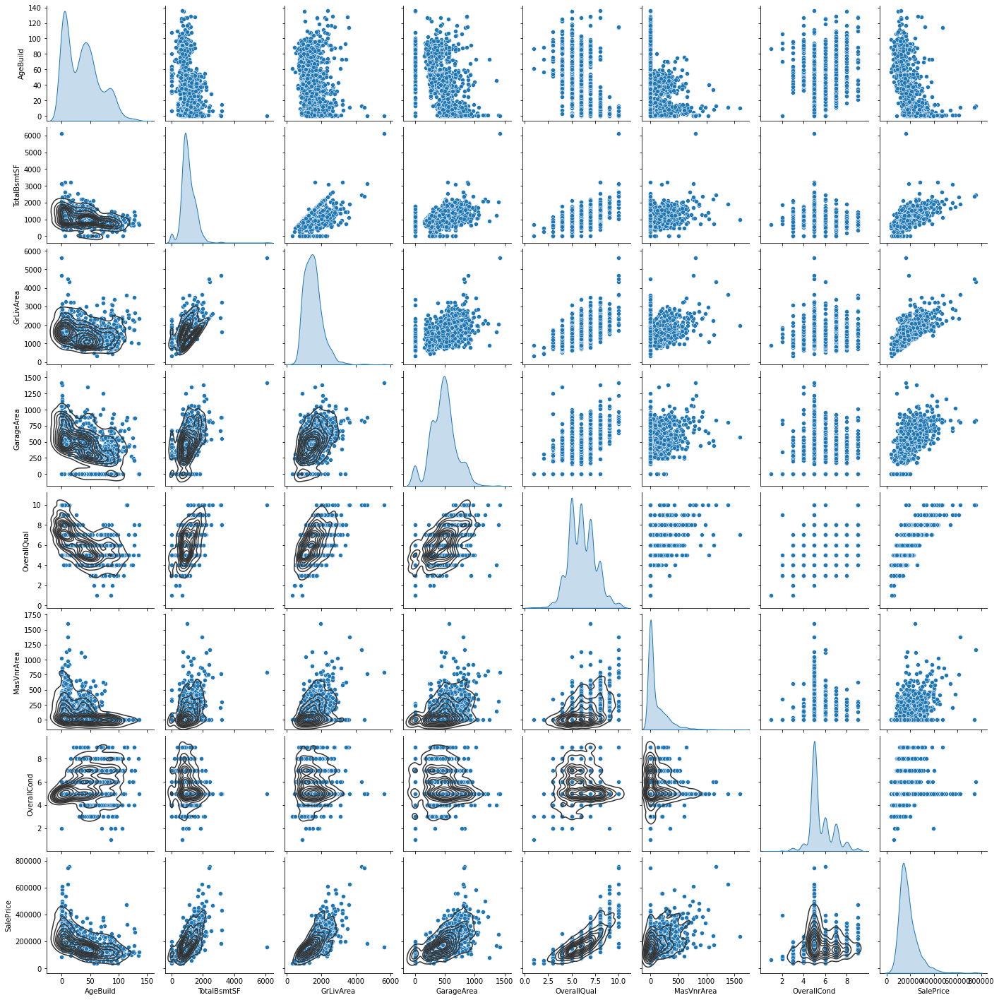

In [49]:
g = sns.pairplot(train_df[important_features+ [target_name]], diag_kind="kde")
g.map_lower(sns.kdeplot, levels=10, color=".2")


# Разделение на тестовую и валидационную выборку

In [54]:
train_X, val_X, train_y, val_y = sklearn.model_selection.train_test_split(
    train_df[~train_df['SalePrice'].isna()].drop(columns =  ['Id',target_name]),
    train_df[~train_df['SalePrice'].isna()][target_name],
    test_size = 0.2,
    shuffle = True,
    random_state=2021
)

<AxesSubplot:xlabel='SalePrice', ylabel='Density'>

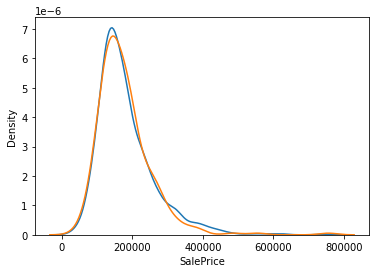

In [56]:
sns.kdeplot(train_y)
sns.kdeplot(val_y)

Из графика наглядно видно, что данные на валидационной и обучающей выборке  распределены одинаков

# Обучение различных моделей

## Random Forest и CatBoost, используя признаки с высокой корреляцией Спирмана, RF с OHE


In [61]:
data = train_df.copy()

new_clm = []
clm_nan = []
for i in data.columns:
    if data[i].count() > 1200:
        new_clm.append(i)
        if data[i].count() < 1460:
            clm_nan.append(i)
data = data[new_clm]  # убираем столбцы, где много пропусков

train_features = []
for clm in data.columns:
    if clm == "SalePrice":
        continue
    stat = sps.spearmanr(data["SalePrice"], data[clm])[0]
    if abs(stat) > 0.3:
        train_features.append(clm)


In [ ]:
def remove_outliers(df, col):
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    return df[(df[col] > (Q1 - 1.5 * IQR)) & (df[col] < (Q3 + 1.5 * IQR))]

data = remove_outliers(data, "SalePrice")

In [64]:
s = [
    "MSZoning",
    "LotShape",
    "Foundation",
    "HeatingQC",
    "CentralAir",
    "SaleCondition",
    "ExterQual",
    "KitchenQual",
]

data_for_rf = data[train_features].drop(columns=s)

train_X, test_X, train_y, test_y = sklearn.model_selection.train_test_split(
    data_for_rf, data["SalePrice"], train_size=0.8, random_state=2021
)


In [65]:
data_for_rf = data[train_features].drop(columns = s)

train_X, test_X , train_y, test_y = sklearn.model_selection.train_test_split(
    data_for_rf,
    data['SalePrice'],
    train_size=0.8,
    random_state=2021
)


In [76]:
reg_rf = RandomForestRegressor(criterion = 'mse')
reg_rf.fit(train_X, train_y)

res = reg_rf.predict(test_X)
math.sqrt(sklearn.metrics.mean_squared_log_error(res, test_y))

0.13917393192170904

In [75]:
scores = cross_val_score(
    reg_rf, train_X, train_y, cv=5, scoring="neg_mean_squared_log_error"
)
np.sqrt(-scores)


array([0.12471039, 0.16600784, 0.13894092, 0.14820434, 0.16288356])

In [78]:
important_features = [i for i in zip(data_for_rf.columns, reg_rf.feature_importances_)]
sorted(important_features, key = lambda p: -p[1])

[('OverallQual', 0.5349164160996354),
 ('GrLivArea', 0.14905175210745195),
 ('TotalBsmtSF', 0.06888481011832415),
 ('GarageArea', 0.04661521776845098),
 ('BsmtFinSF1', 0.03284855756264857),
 ('LotArea', 0.03076711456979769),
 ('1stFlrSF', 0.02061727501735822),
 ('YearBuilt', 0.020058863787729274),
 ('AgeBuild', 0.016862641657451237),
 ('AgeRemod', 0.013997652975565317),
 ('Fireplaces', 0.013243937281976516),
 ('GarageCars', 0.012772314656933825),
 ('YearRemodAdd', 0.011441025063138217),
 ('WoodDeckSF', 0.009821481131469379),
 ('OpenPorchSF', 0.009110484130447164),
 ('TotRmsAbvGrd', 0.004283962407514961),
 ('FullBath', 0.00291568724012553),
 ('HalfBath', 0.0017908064239817846)]

In [81]:
train_features_for_catboost = train_features.copy()

#добавляем признаки, которые не были взяты Спирманом
#но по графикам кажутся полезными
train_features_for_catboost.append('Neighborhood')
train_features_for_catboost.append('OverallCond')
train_features_for_catboost.append('PavedDrive')


In [84]:
data_1 = data[train_features_for_catboost]
data_1.loc[:, "SalePrice"] = data.loc[:, "SalePrice"]

cat_features = [
    "MSZoning",
    "LotShape",
    "Foundation",
    "HeatingQC",
    "CentralAir",
    "SaleCondition",
    "ExterQual",
    "KitchenQual",
]  # >0.3

# некоторые числовые значения лучше рассматривать как категориальные
int_cat_features = ["HalfBath", "OverallCond"]

additional_cat_features = ["Neighborhood", "PavedDrive"]
cat_features.extend(int_cat_features + additional_cat_features)


In [89]:
train_X, test_X, train_y, test_y = sklearn.model_selection.train_test_split(
    data_1[train_features_for_catboost],
    data_1["SalePrice"],
    train_size=0.8,
    random_state=2021,
)

train_pool = catboost.Pool(train_X, label=train_y, cat_features=cat_features)
val_pool = catboost.Pool(test_X, label=test_y, cat_features=cat_features)
test_pool = catboost.Pool(test_X, label=test_y, cat_features=cat_features)


In [90]:
?catboost.CatBoostRegressor
!rm -rf 'catboost_pricing/snapshot.bkp'
catboost_train_dir = 'catboost_pricing'
reg = catboost.CatBoostRegressor(
    od_pval=0.01,
    od_wait=20,
    random_seed=2021,
    train_dir=catboost_train_dir,
    task_type='CPU',
    max_ctr_complexity=4,
    use_best_model=True
)
reg.fit(
    train_pool, 
    eval_set=val_pool,
    plot=True,
    save_snapshot=True,
    snapshot_file='snapshot.bkp',
)   

To draw plots in fit() method you should install ipywidgets and ipython


ImportError: No module named 'ipywidgets'

In [ ]:
math.sqrt(sklearn.metrics.mean_squared_log_error(reg.predict(test_X), test_y))

In [ ]:
shap_info = reg.get_feature_importance(
    data=train_pool, 
    type='ShapValues', 
    verbose=10000
)
shap_values = shap_info[:,:-1]
base_values = shap_info[:,-1]
shap.summary_plot(shap_values, train_X)

In [ ]:
train_df_with_ohe = train_df.copy()
train_features_with_ohe = []
# skip_features = ['OverallQual']
for feature in cat_features:
    # if feature in skip_features: continue
    enc = sklearn.preprocessing.OneHotEncoder(handle_unknown="ignore")
    enc.fit(train_df[feature].unique().reshape(-1, 1))
    list_of_columns = []
    for cat in enc.categories_[0]:
        list_of_columns.append(feature + "_" + str(cat))
    train_features_with_ohe.extend(list_of_columns)
    train_df_with_ohe[list_of_columns] = (
        enc.transform(train_df[feature].values.reshape(-1, 1)).toarray().astype("int")
    )
train_features_for_rf = train_features.copy()
train_features_for_rf.extend(train_features_with_ohe)


In [ ]:

train_df_with_ohe = remove_outliers(train_df_with_ohe, 'SalePrice')
train_df_with_ohe = remove_outliers(train_df_with_ohe, 'LotArea')
train_df_with_ohe = remove_outliers(train_df_with_ohe, 'GrLivArea')
train_df_with_ohe = remove_outliers(train_df_with_ohe, 'TotalBsmtSF')
columns_of_df_with_ohe = train_df_with_ohe[train_features_for_rf].drop(columns = s).columns

In [ ]:
train_X, test_X , train_y, test_y = sklearn.model_selection.train_test_split(
    train_df_with_ohe[train_features_for_rf].drop(columns = s),
    train_df_with_ohe['SalePrice'],
    train_size=0.8,
    random_state=2021
)

reg_rf_with_ohe = RandomForestRegressor(criterion = 'mae')
reg_rf_with_ohe.fit(train_X, train_y)

res = reg_rf_with_ohe.predict(test_X)
math.sqrt(sklearn.metrics.mean_squared_log_error(res, test_y))

In [ ]:
scores = cross_val_score(reg_rf_with_ohe, train_X, train_y, cv=5, scoring='neg_mean_squared_log_error')
np.sqrt(-scores).mean()

In [ ]:
data_test = test_df.copy()
data_test['MSZoning'] = data_test['MSZoning'].fillna(str(random.randint(0, 10)))
data_test['KitchenQual'] = data_test['KitchenQual'].fillna(str(random.randint(0, 10)))
data_test['BsmtFinSF1'] = data_test['BsmtFinSF1'].fillna(int(data_test['BsmtFinSF1'].mean())).astype('int64')
data_test['TotalBsmtSF'] = data_test['TotalBsmtSF'].fillna(int(data_test['TotalBsmtSF'].mean())).astype('int64')
data_test['GarageCars'] = data_test['GarageCars'].fillna(int(data_test['GarageCars'].mean())).astype('int64')
data_test['GarageArea'] = data_test['GarageArea'].fillna(int(data_test['GarageArea'].mean())).astype('int64')

In [ ]:
res_catboost = reg.predict(data_test[train_features_for_catboost])
res_rf = reg_rf.predict(data_test_rf)
res_rf_ex = reg_rf_with_ohe.predict(data_test_rf)

### Полученные результаты
- CatBoost - 0.1459 (6215 место)
- RF - 0.159
- EF с OHE - 0.178

## "Нужно больше Catboost"

In [ ]:
# неинформативные по субьективному мнению признаки
minor_cols = ['LowQualFinSF', 'Fireplaces', 'FireplaceQu', 'WoodDeckSF', 'MoSold', 'YrSold']

# Схожие числовые признаки - обьеденить столбы
baths_cols = ['BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath']
area_cols = ['1stFlrSF', '2ndFlrSF']
porch_cols = ['OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch']

# Столбцы с подозрительным распределением на анализ - посмортеть графики
strange_cols = ['MasVnrArea', 'BsmtFinSF2', 'WoodDeckSF', 'PoolArea'] 
# MiscVal столбец так же сильно разрежен, он позже будет удален по др причине)

# сразу обьединяю столбы перед проверкой остутсвующих  данных
train_df['TmpBsmt'] = train_df[baths_cols].sum(axis=1)
test_df['TmpBsmt'] = train_df[baths_cols].sum(axis=1)
train_df['TmpArea'] = train_df[area_cols].sum(axis=1)
test_df['TmpArea'] = test_df[area_cols].sum(axis=1)
train_df['TmpPorch'] = train_df[porch_cols].sum(axis=1)
test_df['TmpPorch'] = test_df[porch_cols].sum(axis=1)

In [ ]:
s = train_df.isna().mean()
s[s > 0]

В данном варианте было принято решение: т.к. работаем с катбуст - избавляемся от пустых ячеек.
- Там где пропусков меньше 10% делаю dropna 
- Alley, PoolQC, Fence, MiscFeature вообще удаляю колонки тк в них более 80% пропущено. 
- В остальных случаях заменяю значения средними.

In [ ]:
# Иотого решил оставить след признаки
important_features = [
    "Condition1",
    "TmpPorch",
    "OverallQual",
    "TmpArea",
    "TotalBsmtSF",
    "GrLivArea",
    "GarageFinish",
    "ExterQual",
    "KitchenQual",
    "MSZoning",
    "BsmtQual",
    "LotArea",
    "OverallCond",
    "BsmtFinType1",
    "GarageArea",
    "YearRemodAdd",
    "Neighborhood",
    "TmpBsmt",
    "GarageCars",
    "YearBuilt",
]

# В тч категориальные
cat_features = [
    "Condition1",
    "GarageFinish",
    "ExterQual",
    "KitchenQual",
    "MSZoning",
    "BsmtQual",
    "BsmtFinType1",
    "Neighborhood",
]

# Смотрю какие их них имеют пропуски и чем их можно заменить
empty_cols = test_df[important_features].isna().mean()
empty_cols = empty_cols[empty_cols > 0].index.to_list()
for col in empty_cols:
    print(col)
    print(test_df[col].describe())
    print(test_df[col].isna().mean())
    print(test_df[col].unique())


In [ ]:
# Обработка пропусков

empty_cols = test_df[cat_features].isna().mean()
empty_cols = empty_cols[empty_cols > 0].index.to_list()
for col in empty_cols:
    test_df[col].fillna("None", inplace=True)
empty_cols = train_df[cat_features].isna().mean()
empty_cols = empty_cols[empty_cols > 0].index.to_list()
for col in empty_cols:
    train_df[col].fillna("None", inplace=True)
train_df.dropna(inplace=True, subset=important_features)
# train_df[important_features].fillna(train_df.mean(), inplace=True)
test_df[important_features].fillna(test_df.mean(), inplace=True)


In [ ]:
# "Разбираюсь" с выбросами - в итоге все на BoxCox

outliers_cols = ["LotArea", "TmpArea", "GrLivArea", "TotalBsmtSF"]
# В TotalBsmtSF есть 0 значение, для boxcox нельзя
train_df["TotalBsmtSF"] += 1
test_df["TotalBsmtSF"] += 1

train_df["SalePrice"], boxcox_lambda = scipy.stats.boxcox(train_df["SalePrice"])
sns.displot(train_df["SalePrice"], bins=20)

for col in outliers_cols:
    train_df[col], tmp_lambda = scipy.stats.boxcox(train_df[col], lmbda=None)
    test_df[col] = scipy.stats.boxcox(test_df[col], lmbda=tmp_lambda)
    sns.displot(train_df[col], bins=20)


In [ ]:
train_X, val_X, train_y, val_y = sklearn.model_selection.train_test_split(
    train_df[important_features],
    train_df['SalePrice'],
    train_size=0.8,
    random_state=2021
)

test_X = test_df[important_features]

In [ ]:
train_pool = catboost.Pool(train_X, label=train_y, cat_features=cat_features)
val_pool = catboost.Pool(val_X, label=val_y, cat_features=cat_features)
test_pool = catboost.Pool(
    test_X,
    # label=test_y,
    cat_features=cat_features,
)


In [ ]:
?catboost.CatBoostRegressor
!rm -rf 'catboost_pricing/snapshot.bkp'

In [ ]:
catboost_train_dir = 'catboost_pricing'
model = catboost.CatBoostRegressor(
    od_pval=0.05,
    od_wait=20,
    random_seed=2021,
    train_dir=catboost_train_dir,
    task_type='CPU',
    max_ctr_complexity=4,
    use_best_model=True
)
model.fit(
    train_pool, 
    eval_set=val_pool,
    plot=True,
    save_snapshot=True,
    snapshot_file='snapshot.bkp',
)

In [ ]:
test_metrics = model.eval_metrics(
    val_pool,
    metrics=['SMAPE', 'R2'],
    ntree_start=model.best_iteration_ - 1,
    ntree_end=model.best_iteration_,
    eval_period=1,
    thread_count=-1
)
test_metrics

In [ ]:
# Оцениваю влияние признаков

shap_info = model.get_feature_importance(
    data=train_pool, 
    type='ShapValues', 
    verbose=10000
)
shap_values = shap_info[:,:-1]
base_values = shap_info[:,-1]
shap.summary_plot(shap_values, train_X)

## LGBM